In [2]:
import networkx as nx
import pandas as pd
import matplotlib.pyplot as plt

In [3]:
df = pd.read_csv("final_clean.csv", sep =';')

In [4]:
df = df.drop(['Column1'], axis=1)

In [4]:
df

,Season,Name,Transfer Sum,From,FromCountry,FromLanguage,FromLanguageFamily,To,ToCountry,ToLanguage,ToLanguageFamily
0,20/21,Arthur Cabral,"4,40 Mio. €",Palmeiras,Brazil,Portuguese,Romance,FC Basel,Switzerland,German,Germanic
1,20/21,Kaly Sene,"4,00 Mio. €",Juventus U19,Italy,Italian,Romance,FC Basel,Switzerland,German,Germanic
2,20/21,Edon Zhegrova,"3,00 Mio. €",KRC Genk,Belgium,French,Romance,FC Basel,Switzerland,German,Germanic
3,20/21,Andrea Padula,450 Tsd. €,FC Wil 1900,Switzerland,German,Germanic,FC Basel,Switzerland,German,Germanic
4,20/21,Heinz Lindner,ablösefrei,Wehen Wiesbaden,Germany,German,Germanic,FC Basel,Switzerland,German,Germanic
...,...,...,...,...,...,...,...,...,...,...,...
4023,11. Dez,Mickaël Facchinetti,Leihe,FC Lugano,Switzerland,Italian,Romance,Chievo Verona,Italy,Italian,Romance
4024,11. Dez,Palmiro Di Dio,-,FC Lugano,Switzerland,Italian,Romance,FC Lugano U21,Switzerland,Italian,Romance
4025,11. Dez,Patrice Feussi,-,FC Lugano,Switzerland,Italian,Romance,Vereinslos,Vereinslos,Vereinslos,Vereinslos
4026,11. Dez,Rijat Shala,-,FC Lugano,Switzerland,Italian,Romance,Vereinslos,Vereinslos,Vereinslos,Vereinslos


In [5]:
df_temp = df

### Creating different ID's

In [6]:
ids = []
clubs = []
for i , club in enumerate(pd.concat([df['To'],df['From']]).unique()):
    ids.append(i)
    clubs.append(club)
    
df_club_id_from = pd.DataFrame({'id_From': ids, 'From':clubs})    
df_club_id_to = pd.DataFrame({'id_To': ids, 'To':clubs})

In [7]:
idLF = []
LF = []
for i , LaF in enumerate(pd.concat([df['ToLanguageFamily'],df['FromLanguageFamily']]).unique()):
    idLF.append(i)
    LF.append(LaF)
    
df_LF_id_from = pd.DataFrame({'id_FromLF': idLF, 'FromLanguageFamily':LF})    
df_LF_id_to = pd.DataFrame({'id_ToLF': idLF, 'ToLanguageFamily':LF})

In [8]:
idL = []
L = []
for i , La in enumerate(pd.concat([df['ToLanguage'],df['FromLanguage']]).unique()):
    idL.append(i)
    L.append(La)
    
df_L_id_from = pd.DataFrame({'id_FromL': idL, 'FromLanguage':L})    
df_L_id_to = pd.DataFrame({'id_ToL': idL, 'ToLanguage':L})

In [9]:
df_temp = pd.merge(df_temp, df_club_id_from , how = 'inner', on='From')

In [10]:
df_temp = pd.merge(df_temp, df_club_id_to , how = 'inner', on='To')

In [11]:
df_temp = pd.merge(df_temp, df_LF_id_from , how = 'inner', on='FromLanguageFamily')

In [12]:
df_temp = pd.merge(df_temp, df_LF_id_to , how = 'inner', on='ToLanguageFamily')

In [13]:
df_temp = pd.merge(df_temp, df_L_id_from , how = 'inner', on='FromLanguage')

In [14]:
df_temp = pd.merge(df_temp, df_L_id_to , how = 'inner', on='ToLanguage')

End Create ID

In [15]:
#Create Dataframe with all ID's
df_id = df_temp[['id_From','id_To', 'id_FromLF', 'id_ToLF', 'id_FromL', 'id_ToL']]

counting every column ist pretty interesting because of unexpected numbers

In [16]:
df_temp=df_temp.reset_index()
count_to_lang = df_temp['ToLanguage'].value_counts()
count_from = df_temp['From'].value_counts()
count_to_ = df_temp['To'].value_counts()
count_from_lang = df_temp['FromLanguage'].value_counts()
count_to_lang_fam = df_temp['ToLanguageFamily'].value_counts()
count_from_lang_fam = df_temp['FromLanguageFamily'].value_counts()

applying frequencies to the Dataframe

In [17]:
df_temp['freq_From'] = df_temp.groupby(by='From')['From'].transform('count')
df_temp['freq_FromCountry'] = df_temp.groupby(by='FromCountry')['FromCountry'].transform('count')
df_temp['freq_FromLanguage'] = df_temp.groupby(by='FromLanguage')['FromLanguage'].transform('count')
df_temp['freq_FromLanguageFamily'] = df_temp.groupby(by='FromLanguageFamily')['FromLanguageFamily'].transform('count')
df_temp['freq_To'] = df_temp.groupby(by='To')['To'].transform('count')
df_temp['freq_ToCountry'] = df_temp.groupby(by='ToCountry')['ToCountry'].transform('count')
df_temp['freq_ToLanguage'] = df_temp.groupby(by='ToLanguage')['ToLanguage'].transform('count')
df_temp['freq_ToLanguageFamily'] = df_temp.groupby(by='ToLanguageFamily')['ToLanguageFamily'].transform('count')
df_temp

,index,Season,Name,Transfer Sum,From,FromCountry,FromLanguage,FromLanguageFamily,To,ToCountry,...,id_FromL,id_ToL,freq_From,freq_FromCountry,freq_FromLanguage,freq_FromLanguageFamily,freq_To,freq_ToCountry,freq_ToLanguage,freq_ToLanguageFamily
0,0,20/21,Arthur Cabral,"4,40 Mio. €",Palmeiras,Brazil,Portuguese,Romance,FC Basel,Switzerland,...,10,0,4,29,54,1724,136,3035,1789,1901
1,1,19/20,Ramires,Leihe,EC Bahia,Brazil,Portuguese,Romance,FC Basel,Switzerland,...,10,0,1,29,54,1724,136,3035,1789,1901
2,2,14/15,Derlis González,"3,00 Mio. €",Benfica,Portugal,Portuguese,Romance,FC Basel,Switzerland,...,10,0,5,23,54,1724,136,3035,1789,1901
3,3,14/15,Adama Traoré,"1,50 Mio. €",Vit. Guimarães,Portugal,Portuguese,Romance,FC Basel,Switzerland,...,10,0,1,23,54,1724,136,3035,1789,1901
4,4,19/20,Nathan,ablösefrei,Palmeiras,Brazil,Portuguese,Romance,FC Zürich,Switzerland,...,10,0,4,29,54,1724,131,3035,1789,1901
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4023,4023,Dez 13,Heinz Barmettler,ablösefrei,FC Zürich,Switzerland,German,Germanic,Inter Baku,Azerbaijan,...,0,28,145,3203,1964,2056,1,3,3,36
4024,4024,18/19,Marko Devic,ablösefrei,FC Vaduz,Switzerland,German,Germanic,Sabah FK,Azerbaijan,...,0,28,115,3203,1964,2056,1,3,3,36
4025,4025,Dez 13,Bruno Bertucci,?,Grasshopper Club Zürich,Switzerland,German,Germanic,Neftchi Baku,Azerbaijan,...,0,28,179,3203,1964,2056,1,3,3,36
4026,4026,20/21,Levin Wanner,ablösefrei,FC Thun,Switzerland,German,Germanic,FCI,Estonia,...,0,35,115,3203,1964,2056,1,1,1,5


Splitting Dataframe into different seasons for better visualize smaller datasets

In [18]:
df_temp20 = df_temp.loc[df['Season'] == '20/21']
df_temp19 = df_temp.loc[df['Season'] == '19/20']
df_temp18 = df_temp.loc[df['Season'] == '18/19']
df_temp17 = df_temp.loc[df['Season'] == '17/18']
df_temp16 = df_temp.loc[df['Season'] == '16/17']
df_temp15 = df_temp.loc[df['Season'] == '15/16']
df_temp14 = df_temp.loc[df['Season'] == '14/15']
df_temp13 = df_temp.loc[df['Season'] == '13/14']
df_temp12 = df_temp.loc[df['Season'] == '12/13']
df_temp11 = df_temp.loc[df['Season'] == '11/12']
df_temp20

,index,Season,Name,Transfer Sum,From,FromCountry,FromLanguage,FromLanguageFamily,To,ToCountry,...,id_FromL,id_ToL,freq_From,freq_FromCountry,freq_FromLanguage,freq_FromLanguageFamily,freq_To,freq_ToCountry,freq_ToLanguage,freq_ToLanguageFamily
0,0,20/21,Arthur Cabral,"4,40 Mio. €",Palmeiras,Brazil,Portuguese,Romance,FC Basel,Switzerland,...,10,0,4,29,54,1724,136,3035,1789,1901
1,1,19/20,Ramires,Leihe,EC Bahia,Brazil,Portuguese,Romance,FC Basel,Switzerland,...,10,0,1,29,54,1724,136,3035,1789,1901
2,2,14/15,Derlis González,"3,00 Mio. €",Benfica,Portugal,Portuguese,Romance,FC Basel,Switzerland,...,10,0,5,23,54,1724,136,3035,1789,1901
3,3,14/15,Adama Traoré,"1,50 Mio. €",Vit. Guimarães,Portugal,Portuguese,Romance,FC Basel,Switzerland,...,10,0,1,23,54,1724,136,3035,1789,1901
4,4,19/20,Nathan,ablösefrei,Palmeiras,Brazil,Portuguese,Romance,FC Zürich,Switzerland,...,10,0,4,29,54,1724,131,3035,1789,1901
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3708,3708,18/19,Thomas Konrad,-,FC Vaduz,Switzerland,German,Germanic,Vereinslos,Vereinslos,...,0,6,115,3203,1964,2056,174,174,174,174
3709,3709,18/19,Yones Felfel,-,FC Vaduz,Switzerland,German,Germanic,Vereinslos,Vereinslos,...,0,6,115,3203,1964,2056,174,174,174,174
3710,3710,18/19,Marco Mathys,-,FC Vaduz,Switzerland,German,Germanic,Vereinslos,Vereinslos,...,0,6,115,3203,1964,2056,174,174,174,174
3711,3711,17/18,Dejan Janjatovic,-,FC Vaduz,Switzerland,German,Germanic,Vereinslos,Vereinslos,...,0,6,115,3203,1964,2056,174,174,174,174


In [19]:
listyear = [
    'df_temp20',
    'df_temp19',
    'df_temp18',
    'df_temp17',
    'df_temp16',
    'df_temp15',
    'df_temp14',
    'df_temp13',
    'df_temp12',
    'df_temp11',
    'df_temp20',
    'df_temp19',
    'df_temp18',
    'df_temp17',
    'df_temp16',
    'df_temp15',
    'df_temp14',
    'df_temp13',
    'df_temp12',
    'df_temp11']

#### Plotting Networt to show which Teams deliver Players to which language in the Season 20/21
* Saving the plot as a .pdf-File (example: fig.savefig('network20.pdf'))

In [21]:
fig = plt.figure(figsize=(50, 50)) 
g = nx.from_pandas_edgelist(df_temp20, 
                            source = 'From',
                            target = 'To',
                            edge_attr = 'FromLanguageFamily',
                            create_using = nx.DiGraph())

pos = nx.shell_layout(g)
nx.draw(g, pos = pos, with_labels = True) 
plt.axis('off') 
plt.show()
#fig.savefig('network20.pdf')

trys

In [21]:
nc = df_temp['FromLanguage'].value_counts()
dict_color = dict(nc)
dict_color

{'German': 1964,
 'French': 1000,
 'Italian': 608,
 'Vereinslos': 79,
 'English': 64,
 'Spanish': 58,
 'Portuguese': 54,
 'Russian': 20,
 'Dutch': 15,
 'Serbian': 15,
 'Arabic': 14,
 'Hebrew': 12,
 'Greek': 10,
 'Croatian': 10,
 'Polish': 8,
 'Turkish': 7,
 'Swedish': 6,
 'Albanian': 6,
 'Czech': 6,
 'Chinese': 6,
 'Bosnian': 5,
 'Finnish': 5,
 'Unbekannt': 5,
 'Japanese': 5,
 'Hungarian': 4,
 'Norwegian': 4,
 'Latvian': 4,
 'Slovene': 4,
 'pausiert': 4,
 'Romanian': 4,
 'Asante': 3,
 'Danish': 3,
 'Bulgarian': 2,
 'Slovak': 2,
 'Macedonian': 2,
 'Hindi': 1,
 'Maltese': 1,
 'Azerbaijani': 1,
 'Karriereende': 1,
 'Korean': 1,
 'Filipino': 1,
 'Ukrainian': 1,
 'Kazakh': 1,
 'Georgian': 1,
 'Persian Farsi': 1}

In [22]:
node_color_list = df_temp['FromLanguageFamily'].value_counts()

end try

## PREP for coloring nodes to Language Family

In [23]:
temp1 = pd.DataFrame({'ID':df_temp20['From'], 'value':df_temp20['FromLanguageFamily']})
temp2 = pd.DataFrame({'ID':df_temp20['To'], 'value':df_temp20['ToLanguageFamily']})
temp1.append(temp2, ignore_index = True)
colormap = temp1.drop_duplicates()  #subset=['ID']
colormap
#temp1

,ID,value
0,Palmeiras,Romance
1,EC Bahia,Romance
2,Benfica,Romance
3,Vit. Guimarães,Romance
5,Caxias-RS,Romance
...,...,...
3282,Port Vale,Germanic
3283,Liverpool FC,Germanic
3284,Dalkurd FF,Germanic
3285,Panathinaikos,Hellenic


In [24]:
testcol = nx.from_pandas_edgelist(df_temp20, 
                            source = 'From',
                            target = 'To',
                            edge_attr = 'FromLanguageFamily',
                            create_using = nx.DiGraph())

In [25]:
testcol.nodes()

NodeView(('Palmeiras', 'FC Basel', 'EC Bahia', 'Benfica', 'Vit. Guimarães', 'FC Zürich', 'Caxias-RS', 'Santo André-SP', 'Grasshopper Club Zürich', 'Belenenses SAD', 'Benfica U23', 'Rio Ave FC', 'Sporting U19', 'Atlético-GO', 'Tombense', 'FC Porto B', 'FC Vaduz', 'BSC Young Boys', 'FC Porto', 'Monte Azul-SP', 'FC Thun', 'Villa Nova AC', 'Yangon Utd.', 'SC Braga B', 'FC St. Gallen', 'Servette FC', 'FC Winterthur', 'FC Lausanne-Sport', 'FC Sion', 'SC Freiburg', 'FC Wil 1900', 'Xamax', 'FC Biel-Bienne', 'Berliner AK', 'FC Köniz', 'FC Wohlen', 'VfL Wolfsburg', 'Hamburger SV', 'FC Augsburg', 'SC Kriens', 'E. Braunschweig', 'Austria Wien', 'GC Zürich U21', 'Grasshoppers', 'FC Zürich U21', 'BSC YB U21', 'Rapperswil-Jona', 'RB Leipzig', 'VfB Stuttgart', 'FC Schaffhausen', "Bor. M'gladbach", 'Wolves U23', 'FC Heartland', 'FC Everton', 'Aston Villa', 'Arsenal U21', 'Ross County', 'Wigan Athletic', 'FC Reading', 'Dundee FC', 'Newcastle Utd.', 'D.C. United', 'Stoke U23', 'FC Cincinnati', 'Kansas Ci

In [26]:
colormap = colormap.set_index('ID')
colormap=colormap.reindex(testcol.nodes())

colormap

,value
ID,
Palmeiras,Romance
FC Basel,Germanic
EC Bahia,Romance
Benfica,Romance
Vit. Guimarães,Romance
...,...
FC Málaga,NaN
Betis Sevilla,NaN
FC Getafe,NaN


In [40]:
colormap['value']=pd.Categorical(colormap['value'])
colormap['Cat'] = ((colormap['value'].cat.codes))
coloring = colormap['value'].cat.codes
colormap.to_csv('__TEST__.csv', sep=';')

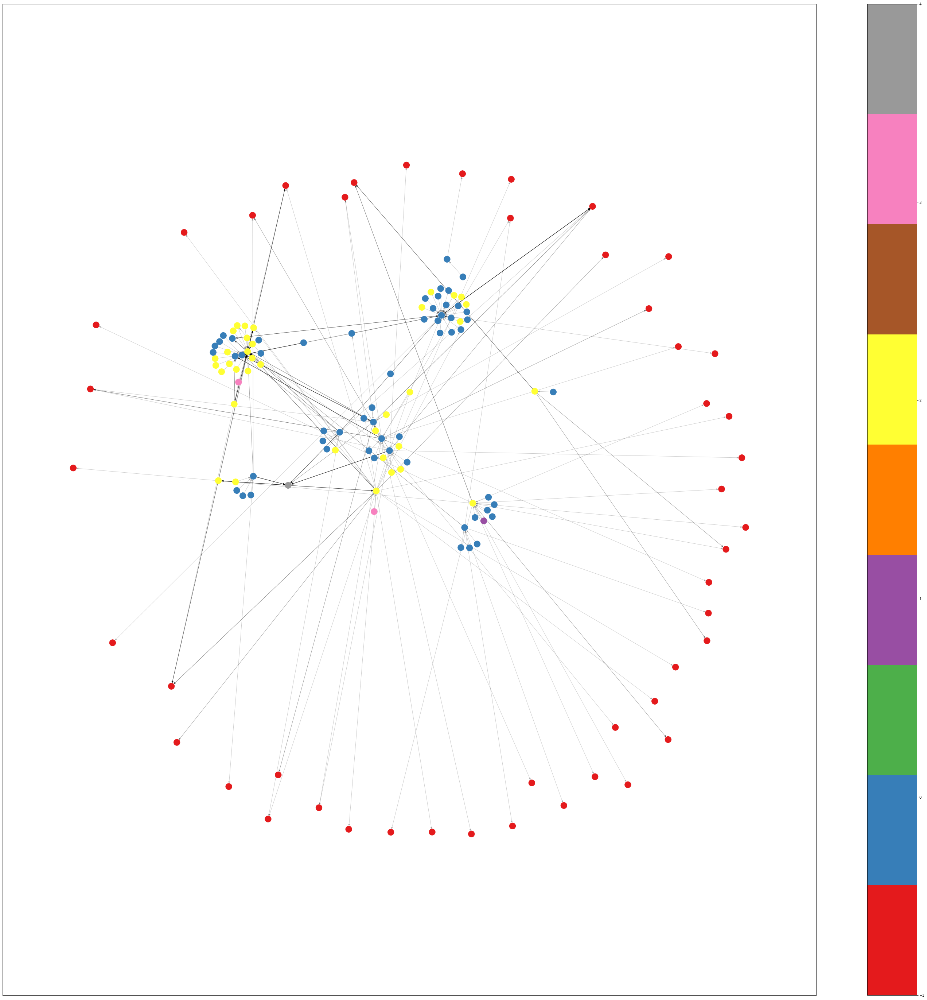

In [41]:
fig = plt.figure(figsize=(50, 50)) 

g = nx.from_pandas_edgelist(df_temp20, 
                            source = 'From',
                            target = 'To',
                            edge_attr = 'FromLanguageFamily',
                            create_using = nx.MultiDiGraph())

pos = nx.spring_layout(g)
ed = nx.draw_networkx_edges(g, pos, alpha=0.2)
nd = nx.draw_networkx_nodes(g, pos, nodelist = g.nodes(), 
                            node_color=coloring, cmap=plt.cm.Set1,
                            edge_color='black', with_labels = True,
                            font_size=5) 
plt.axis('equal')
plt.colorbar(nd)
plt.show()
fig.savefig('_TEST_color.pdf')

PREP Color all

In [53]:
tempall = pd.DataFrame({'ID':df_temp['From'], 'value':df_temp['FromLanguageFamily']})
tempall2 = pd.DataFrame({'ID':df_temp['To'], 'value':df_temp['ToLanguageFamily']})
tempall.append(tempall2, ignore_index = True)
colormapall = tempall.drop_duplicates()  #subset=['ID']
colormapall
#temp1

,ID,value
0,Palmeiras,Romance
1,EC Bahia,Romance
2,Benfica,Romance
3,Vit. Guimarães,Romance
5,Caxias-RS,Romance
...,...,...
3321,FC Drita,Albanian
3322,KF Vllaznia,Albanian
3323,Sliema Wander.,Semitic
3324,FC Astana,Turkic


In [43]:
testcolall = nx.from_pandas_edgelist(df_temp, 
                            source = 'From',
                            target = 'To',
                            edge_attr = 'FromLanguage',
                            create_using = nx.MultiDiGraph())

In [44]:
testcolall.nodes()

NodeView(('Palmeiras', 'FC Basel', 'EC Bahia', 'Benfica', 'Vit. Guimarães', 'FC Zürich', 'Caxias-RS', 'Santo André-SP', 'Grasshopper Club Zürich', 'Belenenses SAD', 'Benfica U23', 'Rio Ave FC', 'Sporting U19', 'Atlético-GO', 'Tombense', 'FC Porto B', 'FC Vaduz', 'BSC Young Boys', 'FC Porto', 'Monte Azul-SP', 'FC Thun', 'Villa Nova AC', 'Yangon Utd.', 'SC Braga B', 'FC St. Gallen', 'FC Aarau', 'Tubarão-SC', 'Juventus U19', 'Udinese Calcio', 'AS Rom', 'Inter Mailand', 'Delfino Pescara', 'Inter U19', 'FC Chiasso', 'FC Lugano', 'FC Empoli', 'Novara Calcio', 'Lazio Rom', 'AC Bellinzona', 'Juventus U23', 'Chievo Verona', 'SSC Bari', 'FC Locarno', 'US Palermo', 'FC Luzern', 'FC Turin', 'FC Bologna', 'Juventus Turin', 'Genua CFC', 'Grasshoppers', 'SC Kriens', 'Rapperswil-Jona', 'FC Winterthur', 'FC Wil 1900', 'FC Köniz', 'FC Wohlen', 'FC Schaffhausen', 'FC Dietikon', 'FC Münsingen', 'United Zürich', 'SC Brühl SG', 'FC Tuggen', 'BSC YB U21', 'SC Buochs', 'Schwamendingen', 'FC Littau', 'KRC Genk

In [45]:
colormapall = colormapall.set_index('ID')
colormapall = colormapall.reindex(testcolall.nodes())

colormapall

,value
ID,
Palmeiras,Romance
FC Basel,Germanic
EC Bahia,Romance
Benfica,Romance
Vit. Guimarães,Romance
...,...
Pr. Niederkorn,NaN
Sabah FK,NaN
Neftchi Baku,NaN


In [46]:
colormapall['value']=pd.Categorical(colormapall['value'])
colormapall['value'].cat.codes
coloringall = colormapall['value'].cat.codes

/Users/nicowyss/anaconda3/lib/python3.8/site-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 9 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/Users/nicowyss/anaconda3/lib/python3.8/site-packages/matplotlib/backends/backend_agg.py:183: RuntimeWarning: Glyph 9 missing from current font.
  font.set_text(s, 0, flags=flags)


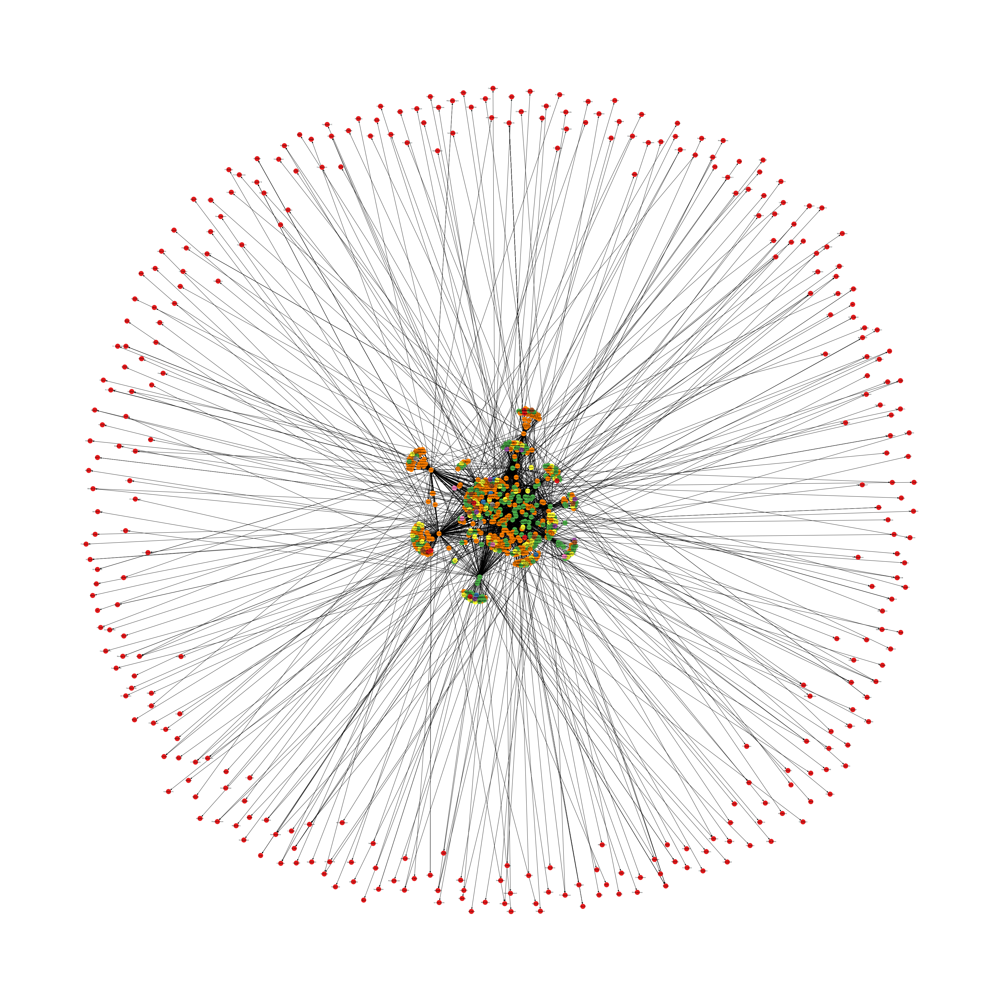

/Users/nicowyss/anaconda3/lib/python3.8/site-packages/matplotlib/backends/_backend_pdf_ps.py:62: RuntimeWarning: Glyph 9 missing from current font.
  font.set_text(s, 0.0, flags=ft2font.LOAD_NO_HINTING)


In [47]:
fig = plt.figure(figsize=(50, 50)) 

g = nx.from_pandas_edgelist(df_temp, 
                            source = 'From',
                            target = 'To',
                            edge_attr = 'FromLanguage',
                            create_using = nx.MultiDiGraph())

nx.draw(g, pos = nx.spring_layout(g), node_color=colormapall['value'].cat.codes, cmap=plt.cm.Set1, edge_color='black', with_labels = True, font_size=5) 
plt.axis('equal') 

plt.show()
fig.savefig('___Final_Network_all.pdf')

NameError: name 'formatted_edge_labels' is not defined

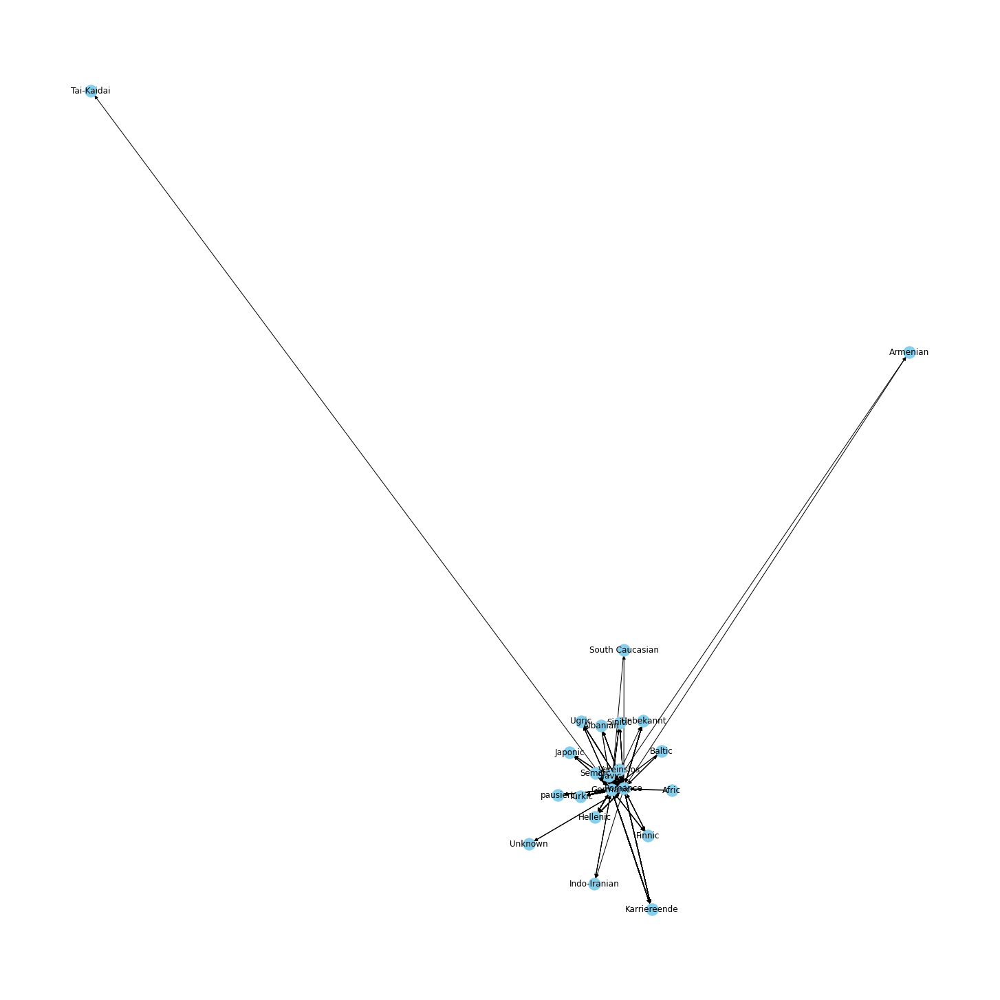

In [48]:
fig = plt.figure(figsize=(20, 20)) 

g = nx.from_pandas_edgelist(df_temp, 
                            source = 'FromLanguageFamily',
                            target = 'ToLanguageFamily',
                            edge_attr = 'FromLanguageFamily',
                            create_using = nx.MultiDiGraph())

edge = df_temp20['FromLanguageFamily']
pos = nx.spring_layout(g)
nx.draw(g, with_labels=True, node_color='skyblue', edge_cmap=plt.cm.Blues, pos=pos)
edge_labels = nx.get_edge_attributes(g,'edge')
nx.draw_networkx_edge_labels(g,pos,edge_labels=formatted_edge_labels,font_color='red')
plt.show()
fig.savefig('networkedgelabel.pdf')

In [49]:
fig = plt.figure(figsize=(10, 10)) 
g = nx.from_pandas_edgelist(df_tempZ20, 
                            source = 'FromLanguageFamily',
                            target = 'To',
                            edge_attr = 'ToLanguageFamily',
                            create_using = nx.MultiDiGraph())
nx.draw(g, with_labels = True) 
plt.axis('scaled') 
plt.show()
fig.savefig('networkTestZ20.pdf')

NameError: name 'df_tempZ20' is not defined

<Figure size 720x720 with 0 Axes>

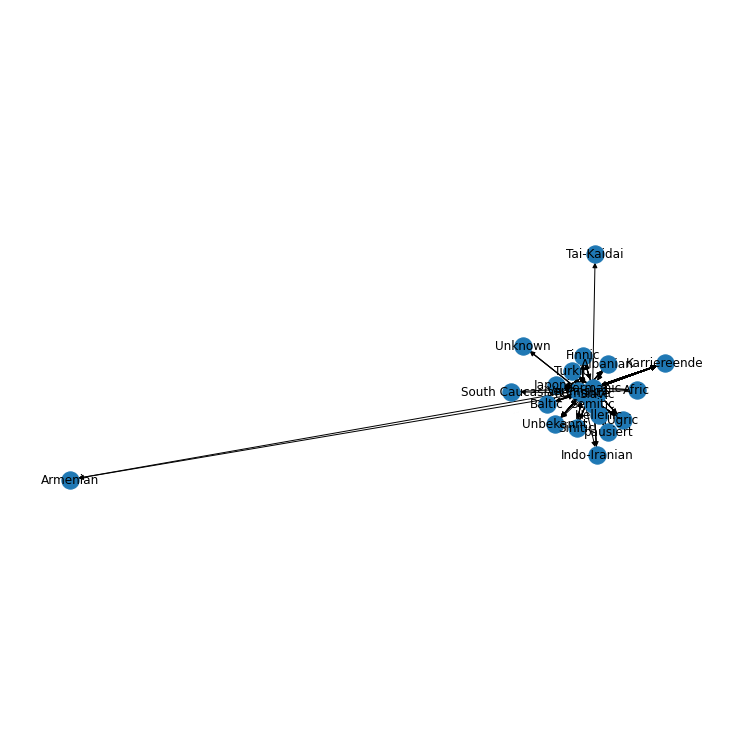

In [50]:
fig = plt.figure(figsize=(10, 10)) 
q = nx.from_pandas_edgelist(df_temp, 
                            source = 'From',
                            target = 'To',
                            edge_attr = 'ToLanguageFamily',
                            create_using = nx.Graph())
nx.draw(g, with_labels = True) 
plt.axis('equal') 
plt.show()
fig.savefig('network_all.pdf')

In [51]:
sorted(betCent, key=betCent.get, reverse=True)[:5]

NameError: name 'betCent' is not defined

In [ ]:
pos = nx.spring_layout(q)

betCent = nx.betweenness_centrality(q, normalized=True, endpoints=True)
node_color = [20000.0 * q.degree(v) for v in q]
node_size =  [v * 10000 for v in betCent.values()]
plot = plt.figure(figsize = (20,20))
nx.draw_networkx(q, pos=pos, with_labels=True,
                 font_size=2,
                 node_color=node_color,
                 node_size=node_size,
                 create_using = nx.MultiDiGraph())
plt.axis('off')
plot.savefig('network_all2.pdf')

In [ ]:
 print(nx.info(g))